# Unit 5 - Financial Planning


In [135]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [137]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [139]:
# Set current amount of crypto assets
my_btc = 1.2
my_eth = 5.3

In [141]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"

In [164]:
# Fetch current BTC price
import json
btc_res = requests.get(btc_url)
btc_res.content
btc_data = btc_res.json()

btc_json_data = json.dumps(btc_data)

# print(btc_json_data)

btc_df = pd.DataFrame(btc_data['data']['1'])
btc_df
drop_these = ['id', 'name', 'symbol', 'website_slug', 'rank', 'circulating_supply', 'total_supply', 'max_supply', 'last_updated']
btc_price_df = btc_df.drop(columns=drop_these)

btc_price = btc_price_df.iloc[1][0]
btc_price = btc_price['price']

# btc_price

# Fetch current ETH price
eth_res = requests.get(eth_url)
eth_res.content
eth_data = eth_res.json()

eth_json_data = json.dumps(eth_data)

# print(eth_json_data)

eth_df = pd.DataFrame(eth_data['data']['1027'])
eth_df
drop_columns = ['id', 'name', 'symbol', 'website_slug', 'rank', 'circulating_supply', 'total_supply', 'max_supply', 'last_updated']
eth_price_df = eth_df.drop(columns=drop_columns)

eth_price = eth_price_df.iloc[1][0]
eth_price = eth_price['price']

print(f"BTC = ${btc_price}")
print(f"ETH = ${eth_price}")

# Compute current value of my crpto
my_btc_value = (btc_price * my_btc)
my_eth_value = (eth_price * my_eth)

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f}")

BTC = $11394.78
ETH = $381.85
The current value of your 1.2 BTC is $13673.74
The current value of your 5.3 ETH is $2023.81


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [145]:
# Current amount of shares
my_agg = 200
my_spy = 50

In [147]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version = "v2"
)

In [149]:
# Format current date as ISO format
start_date = pd.Timestamp("2017-05-01", tz="America/New_York").isoformat()
end_date = pd.Timestamp("2020-10-11", tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
df_ticker = api.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date).df
# Preview DataFrame
df_ticker.head()

AGG                                       \
                             open      high      low    close   volume   
2017-05-01 00:00:00-04:00  108.86  108.9599  108.620  108.735  2335646   
2017-05-02 00:00:00-04:00  108.68  108.9400  108.679  108.890  2570794   
2017-05-03 00:00:00-04:00  108.97  108.9900  108.770  108.795  1765578   
2017-05-04 00:00:00-04:00  108.55  108.7000  108.550  108.665  1789624   
2017-05-05 00:00:00-04:00  108.72  108.7400  108.570  108.720  1287794   

                              SPY                                       
                             open      high      low   close    volume  
2017-05-01 00:00:00-04:00  238.69  239.1700  238.195  238.65  38750688  
2017-05-02 00:00:00-04:00  238.84  238.9800  238.300  238.79  39563850  
2017-05-03 00:00:00-04:00  238.32  238.8775  237.700  238.52  47292627  
2017-05-04 00:00:00-04:00  238.83  238.9225  237.780  238.75  46170233  
2017-05-05 00:00:00-04:00  239.18  239.7200  238.680  239.72  43733544

In [165]:
# Pick AGG and SPY close prices
agg_close_price = df_ticker['AGG']['close'][-1]
spy_close_price = df_ticker['SPY']['close'][-1]

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price:0.2f}")
print(f"Current SPY closing price: ${spy_close_price:0.2f}")


Current AGG closing price: $117.70
Current SPY closing price: $346.84


In [153]:
# Compute the current value of shares

my_agg_value = (my_spy) * (agg_close_price)

my_spy_value = (my_agg) * (spy_close_price)

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $69368.00
The current value of your 200 AGG shares is $5885.25


### Savings Health Analysis

In [155]:
# Set monthly household income
monthly_income = 12000

# Create savings DataFrame
share_value = (my_agg_value + my_spy_value)
crypto_value = (my_btc_value + my_eth_value)
data = {'assets':["crypto", 'shares'],'amount':[crypto_value, share_value]}

df_savings = pd.DataFrame(data)

# Display savings DataFrame

df_savings.set_index('assets', inplace=True)
df_savings

,amount
assets,
crypto,15697.541
shares,75253.250


In [ ]:
# plot pie chart of asset value
plot = df_savings.plot.pie(y='amount', title="Total savings")


In [167]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3
total_savings = crypto_value + share_value
shortage = emergency_fund - total_savings

# Calculate total amount of savings
print(f" Your emergency fund = ${total_savings:0.2f}")

# Validate saving health
if total_savings > emergency_fund:
    print('You are in good shape!')
elif total_savings == emergency_fund:
    print("Congrats on reaching your emergency fund goal!")
else:
    print(f"You need ${shortage:0.2f} to meet emergency fund goal.")

 Your emergency fund = $90950.79
You are in good shape!


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [168]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-08-07', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-08-07', tz='America/New_York').isoformat()

In [169]:
# Get 5 years' worth of historical data for SPY and AGG
tickers = ["AGG", "SPY"]
timeframe = "1D"
df_stock_data = api.get_barset(
    tickers,
    timeframe,
    start=start_date,
    end=end_date).df
# Display sample data
df_stock_data.head()

AGG                                         SPY  \
                             open      high      low   close   volume    open   
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167  208.16   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778  209.28   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907  208.98   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979  207.11   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173  208.73   

                                                              
                             high     low   close     volume  
2015-08-07 00:00:00-04:00  208.34  206.87  207.93   87669782  
2015-08-10 00:00:00-04:00  210.67  209.28  210.58   66755890  
2015-08-11 00:00:00-04:00  209.47  207.76  208.63   88424557  
2015-08-12 00:00:00-04:00  209.14  205.36  208.89  136171450  
2015-08-13 00:00:00-04:00  209.55  208.01  208.63   77197796

In [170]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
MC_df_stock_data = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [.40, .60],
    num_simulation = 500,
    num_trading_days = 252*30
)

In [171]:
# Printing the simulation input data
MC_df_stock_data.portfolio_data.head()

AGG                                      \
                             open      high      low   close   volume   
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173   

                                           SPY                          \
                          daily_return    open    high     low   close   
2015-08-07 00:00:00-04:00          NaN  208.16  208.34  206.87  207.93   
2015-08-10 00:00:00-04:00    -0.001374  209.28  210.67  209.28  210.58   
2015-08-11 00:00:00-04:00     0.003301  208.98  209.47  207.76  208.63   
2015-08-12 00:00:00-04:00    -0.000548  207.11  209.14  205.36  208.89   
2015-08-13 00:00:00-04:00    -0.001920  208.73  209.55  208.01  208.63   

                                                   
                              volume daily_return  
2015-08-07 00:00:00-04:00   87669782          NaN  
2015-08-10 00:00:00-04:00   66755890     0.012745  
2015-08-11 00:00:00-04:00   88424557    -0.009260  
2015-08-12 00:00:00-04:00  136171450     0.001246  
2015-08-13 00:00:00-04:00   77197796    -0.001245

In [133]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_df_stock_data.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.987282,1.010606,1.003431,0.994675,0.996791,1.005367,0.999754,1.004783,0.998737,1.005058,...,1.004626,1.002922,0.993772,1.000963,0.997906,0.999987,0.998743,0.993544,1.001861,1.007804
2,0.987170,1.013212,1.004024,1.001871,0.986339,0.992607,0.992732,1.012270,1.004533,1.005445,...,1.003029,1.008329,0.992984,0.998717,0.998863,0.993723,0.987214,0.981482,0.997273,1.010193
3,0.977455,1.031554,1.001666,0.987841,0.982698,0.982205,1.000340,1.028693,1.007918,1.015129,...,1.010253,1.032146,0.997685,1.002034,1.002355,1.009293,0.996746,0.970656,1.005508,1.012268
4,0.986033,1.028829,0.989223,0.993364,0.984141,0.996598,1.003628,1.032258,1.007622,1.022459,...,1.016481,1.038090,1.004053,1.008235,1.004582,1.016698,0.995749,0.967619,1.017081,1.009529
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,10.508937,3.299070,1.770973,23.453604,12.221177,11.795071,6.568837,9.050180,6.995503,5.053317,...,5.467895,9.591838,6.841830,3.107579,5.012009,16.135177,11.566064,16.024019,12.542098,10.291952
7557,10.512403,3.328474,1.793635,23.475177,12.240383,11.797969,6.428277,9.016620,7.054745,5.054097,...,5.414782,9.534521,6.850819,3.114744,4.978921,16.215823,11.364608,16.029871,12.379319,10.242675
7558,10.486609,3.289501,1.821525,23.376461,12.223765,11.934204,6.401227,8.993510,7.114516,5.030528,...,5.428741,9.625440,6.782582,3.143566,4.901253,16.314318,11.319951,15.864344,12.450407,10.154703
7559,10.474614,3.278812,1.836476,23.121330,12.286781,11.861466,6.384442,8.964800,7.141627,5.033817,...,5.409473,9.524567,6.804150,3.147947,4.949633,16.347566,11.352442,15.615509,12.492973,10.080986


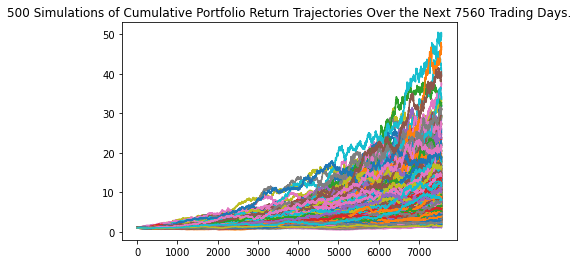

In [175]:
# Plot simulation outcomes
line_plot = MC_df_stock_data.plot_simulation()

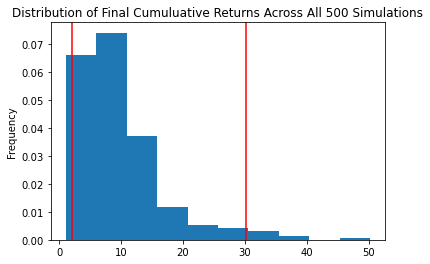

In [174]:
# Plot probability distribution and confidence intervals
dist_plot = MC_df_stock_data.plot_distribution()

### Retirement Analysis

In [176]:
# Fetch summary statistics from the Monte Carlo simulation results
portfolio_sim_summary = MC_df_stock_data.summarize_cumulative_return()
print(portfolio_sim_summary)
# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              9.855859
std               7.008151
min               1.066354
25%               5.372545
50%               7.991398
75%              12.304608
max              50.267137
95% CI Lower      2.046409
95% CI Upper     30.251715
Name: 7560, dtype: float64


### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [177]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
portfolio_ci_lower = round(portfolio_sim_summary[8]*20000,2)
portfolio_ci_upper = round(portfolio_sim_summary[9]*20000,2)


# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${portfolio_ci_lower} and ${portfolio_ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $40928.18 and $605034.3


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [178]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000

portfolio_ci_lower = round(portfolio_sim_summary[8]*(initial_investment))
portfolio_ci_upper = round(portfolio_sim_summary[9]*(initial_investment))

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${portfolio_ci_lower} and ${portfolio_ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $61392.0 and $907551.0


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [146]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [148]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [150]:
# Plot simulation outcomes
# YOUR CODE HERE!

In [152]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [154]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

In [156]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

NameError: name 'ci_lower_five' is not defined

### Ten Years Retirement Option

In [158]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [159]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [160]:
# Plot simulation outcomes
# YOUR CODE HERE!

In [161]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [162]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

In [163]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

NameError: name 'ci_lower_ten' is not defined